In [6]:
import sys
import os
os.chdir('/scratch/nhl256/dl_project/code/')

import cv2
import os
import random
import numpy as np
import pandas as pd

import matplotlib
import matplotlib.pyplot as plt
matplotlib.rcParams['figure.figsize'] = [5, 5]
matplotlib.rcParams['figure.dpi'] = 200

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision

from data_helper import UnlabeledDataset, LabeledDataset
from helper import collate_fn, draw_box

# All the images are saved in image_folder
# All the labels are saved in the annotation_csv file
image_folder = 'data/data'
annotation_csv = 'data/data/annotation.csv'
# You shouldn't change the unlabeled_scene_index
# The first 106 scenes are unlabeled
unlabeled_scene_index = np.arange(106)
# The scenes from 106 - 133 are labeled
# You should devide the labeled_scene_index into two subsets (training and validation)
labeled_scene_index = np.arange(106, 134)


NUM_SAMPLE_PER_SCENE = 126
NUM_IMAGE_PER_SAMPLE = 6
image_names = [
    'CAM_FRONT_LEFT.jpeg',
    'CAM_FRONT.jpeg',
    'CAM_FRONT_RIGHT.jpeg',
    'CAM_BACK_LEFT.jpeg',
    'CAM_BACK.jpeg',
    'CAM_BACK_RIGHT.jpeg',
    ]

from PIL import Image

from skimage.color import lab2rgb, rgb2lab, rgb2gray
import copy, time

In [ ]:
# ! pip install opencv-python


In [8]:
class GrayDataset(torch.utils.data.Dataset):
    def __init__(self, image_folder, scene_index, transform, train = True):
        self.image_folder = image_folder
        self.scene_index = scene_index
        self.transform = transform
        self.first_dim = 'image'
        self.is_training = train
        np.random.seed(1)
        
    def __len__(self):
        return self.scene_index.size * NUM_SAMPLE_PER_SCENE * NUM_IMAGE_PER_SAMPLE
    
    def __getitem__(self, index):
        scene_id = self.scene_index[index//(NUM_SAMPLE_PER_SCENE * NUM_IMAGE_PER_SAMPLE)]
        sample_id = (index % (NUM_SAMPLE_PER_SCENE*NUM_IMAGE_PER_SAMPLE)) // NUM_IMAGE_PER_SAMPLE
        image_name = image_names[index % NUM_IMAGE_PER_SAMPLE]
        
        image_path = os.path.join(self.image_folder, f'scene_{scene_id}', f'sample_{sample_id}', image_name) 
            
        image = Image.open(image_path) 
        image_original = self.transform(image)# image original 3x256x306
        
        # Starting conversion
        image_original = image_original.numpy().transpose(1,2,0)
        image_lab = rgb2lab(image_original)
        #image_lab = (image_lab+128)/255
        image_ab = image_lab[:, :, 1:3]
        image_ab = torch.from_numpy(image_ab.transpose((2,0,1))).float()
        image_original = rgb2gray(image_original)
        image_original = torch.from_numpy(image_original).unsqueeze(0).float()
        
        return image_original, image_ab
     

In [9]:
transform = torchvision.transforms.Compose([torchvision.transforms.ToTensor()])

BATCH_SIZE=1
random.seed(1008)
random.shuffle(unlabeled_scene_index)
train_scene = unlabeled_scene_index[:85]
val_scene = unlabeled_scene_index[85:]

train_set = GrayDataset(image_folder = image_folder, scene_index= train_scene,
                        transform = transform, train=True)
val_set = GrayDataset(image_folder=image_folder, scene_index=  val_scene, 
                        transform = transform, train=False)

train_loader = torch.utils.data.DataLoader(train_set, batch_size= BATCH_SIZE, 
                                           shuffle=True, num_workers=2)
val_loader = torch.utils.data.DataLoader(val_set, batch_size= BATCH_SIZE, 
                                           shuffle=True, num_workers=2)

In [10]:
def to_rgb(grayscale_input, ab_input):
    '''
    input in shape torch tensoir CxHx W
    '''
    color_image = torch.cat((grayscale_input, ab_input), 0).numpy().transpose(1,2,0)
    color_image[:, :, 0:1] = color_image[:, :, 0:1] * 100
    color_image = lab2rgb(color_image.astype(np.float64))
    return color_image # returns a numpy array in shape h x w x 3


In [11]:
gray_image, image_ab = iter(train_loader).next()


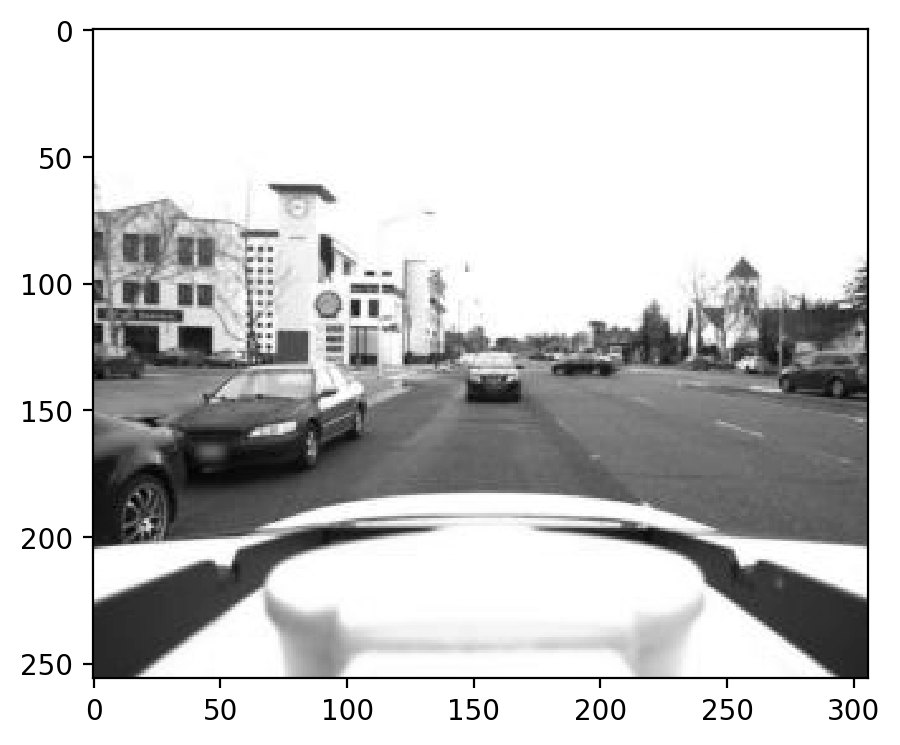

In [12]:
plt.imshow(gray_image.squeeze().cpu(), cmap = 'gray')

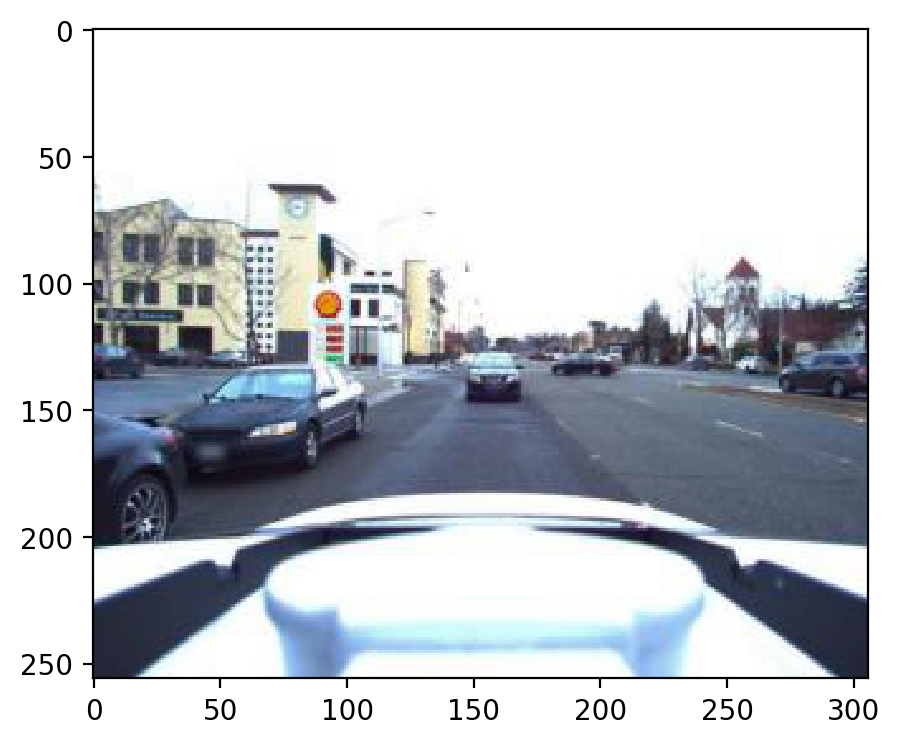

In [13]:
colored = to_rgb(gray_image.squeeze(0).cpu(), image_ab.squeeze(0).cpu())
plt.imshow(colored)

In [14]:
class color_encoder(nn.Module):
    def __init__(self):
        super(color_encoder, self).__init__()
        encoder = torchvision.models.resnet18(pretrained=False)
        encoder = list(encoder.children())[1:-3]
        encoder = [nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)] + encoder
        self.encoder = nn.Sequential(*encoder)
        
    def forward(self, x):
        x = self.encoder(x)
        return x 

In [15]:
temp_encoder= color_encoder()

In [16]:
test_output = temp_encoder(gray_image)

In [17]:
class _SameDecoder(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride, num_layers, out_activation = 'relu'):
        super(_SameDecoder, self).__init__()
        layers = [
            nn.ConvTranspose2d(in_channels, in_channels, kernel_size=kernel_size, stride=stride),
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        ]
        layers += [
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True) 
        ]*(num_layers-2)
        
        layers += [
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True) if out_activation == 'relu' else nn.Sigmoid(),
        ]
        self.decode = nn.Sequential(*layers)
    def forward(self, x):
        return self.decode(x)
    
def get_upsampling_weight(in_channels, out_channels, kernel_size):
    """Make a 2D bilinear kernel suitable for upsampling"""
    factor = (kernel_size + 1) // 2
    if kernel_size % 2 == 1:
        center = factor - 1
    else:
        center = factor - 0.5
    og = np.ogrid[:kernel_size, :kernel_size]
    filt = (1 - abs(og[0] - center) / factor) * \
           (1 - abs(og[1] - center) / factor)
    weight = np.zeros((in_channels, out_channels, kernel_size, kernel_size),
                      dtype=np.float64)
    weight[range(in_channels), range(out_channels), :, :] = filt
    return torch.from_numpy(weight).float()

In [29]:
class color_decoder(nn.Module):
    def __init__(self):
        super(color_decoder, self).__init__()
        self.dec1 = _SameDecoder(256, 512,kernel_size=2, stride=2, num_layers=4)
        self.dec2 = _SameDecoder(512, 256,kernel_size=2, stride=2, num_layers=4)
        self.dec3 = _SameDecoder(256, 128,kernel_size=2, stride=2, num_layers=2)
        self.dec4 = _SameDecoder(128, 64,kernel_size=2, stride=2, num_layers=2)
        self.conv_out = nn.Conv2d(64, 2, 3 , padding=1)
        
        self.final_upsample = nn.Upsample((256, 306), mode='bilinear', align_corners=False)
        #self.sigmoid = nn.Sigmoid()
        self._initialize_weights()
        
    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.ConvTranspose2d):
                assert m.kernel_size[0] == m.kernel_size[1]
                initial_weight = get_upsampling_weight(
                    m.in_channels, m.out_channels, m.kernel_size[0])
                m.weight.data.copy_(initial_weight)
                
    def forward(self, x):
        x = self.dec1(x)
        x= self.dec2(x)
        x = self.dec3(x)
        x = self.dec4(x)
        x = self.conv_out(x)
        #print('after layers the size is', x.size())
        x = self.final_upsample(x)
        #x = self.sigmoid(x)
        return x

In [30]:
class color_model(nn.Module):
    def __init__(self):
        super(color_model, self).__init__()
        self.encoder = color_encoder()
        self.decoder = color_decoder()
        
    def forward(self, x):
        mid = self.encoder(x)
        output = self.decoder(mid)
        
        return output

In [31]:
cuda = torch.cuda.is_available()
device = torch.device("cuda:0" if cuda else "cpu")
temp_encoder= color_encoder().to(device)

In [32]:
gray_image = gray_image.to(device)
mid = temp_encoder(gray_image)

In [33]:
mid.shape

torch.Size([1, 256, 16, 20])

In [34]:
temp_decoder = color_decoder().to(device)

In [35]:
output = temp_decoder(mid)

In [36]:
output.shape

torch.Size([1, 2, 256, 306])

In [37]:
criterion = nn.MSELoss()

In [38]:
criterion(output.cpu(), image_ab.cpu())

tensor(49.3091, grad_fn=<MseLossBackward>)

In [39]:
temp_model = color_model().to(device)
gray_image = gray_image.to(device)
predicted_ab = temp_model(gray_image)

In [40]:
predicted_ab.shape

torch.Size([1, 2, 256, 306])

In [41]:
def train_eval_model(model, train_loader, val_loader, criterion, optimizer, 
                    num_epochs, checkpoint, to_save, eval_every=500, print_every = 1000):
    
    start_time = time.time()
    if checkpoint:
        pt = torch.load(checkpoint)
        model.load_state_dict(pt['best_model'])
        optimizer.load_state_dict(pt['optimizer'])
        best_loss = pt['best_loss']
        print('loading weights')
    else: 
        best_loss = 1e10
    
    loss_dict = {'train':[], 'val':[]}
    curr_iteration = 0
    curr_loss = 0.0
    total_iteration = 0
    
    for epoch in range(num_epochs):
        epoch_start =time.time()
        print('Epoch {}/{}'.format(epoch+1, num_epochs))
        print('-'*10)
        for i, (gray_image, image_ab) in enumerate(train_loader):
            model.train()
            train_start = time.time()
            
            inputs_gray = gray_image.to(device)
            target_ab = image_ab.to(device)
            
            optimizer.zero_grad()
            outputs_ab = model(inputs_gray)
            
            loss = criterion(outputs_ab, target_ab)
            
            curr_loss += loss.item()
            loss.backward()
            optimizer.step()
            
            curr_iteration +=1
            total_iteration +=1
            
            if curr_iteration % eval_every == 0:
                curr_loss/=(curr_iteration*BATCH_SIZE)
                loss_dict['train'].append(curr_loss)
                print('Current training loss is %f'%(curr_loss))
                print('Training iteration %d takes %f'%(curr_iteration, time.time() - train_start))
                train_start = time.time()
                curr_loss = 0.0
                
                eval_loss = 0.0
                total = 0
                model.eval()
                val_start = time.time()
                with torch.no_grad():
                    for i, (image_gray, image_ab) in enumerate(val_loader):
                        inputs_gray = image_gray.to(device)
                        target_ab = image_ab.to(device)
                        
                        outputs_ab = model(inputs_gray)
                        loss = criterion(outputs_ab.cpu(), target_ab.cpu())
                        eval_loss += loss.item()
                        total += image_gray.size(0)
                        
                eval_loss/=total
                loss_dict['val'].append(eval_loss)
                
                print('Current validatoin loss is %f'%(eval_loss))
                print('Current validation takes %f'%(time.time() - val_start))
                
                if eval_loss < best_loss:
                    print('saving best model')
                    best_loss = eval_loss
                    checkpoint = {'best_model': model.state_dict(), 
                                  'optimizer': optimizer.state_dict(), 
                                  'best_loss': best_loss}
                    torch.save(checkpoint, to_save)
                    
                   
                    
                if total_iteration %print_every == 0:
                    print('printing test image')
                    fig, ax = plt.subplots(5, 2, figsize=(15,30))
                    test_idx = [1731, 2894, 4414, 9504, 419]
                    for fig_i, i in enumerate(test_idx):
                        inputs = val_set[i][0].unsqueeze(0).to(device)
                        with torch.no_grad():
                            outputs = model(inputs).cpu().detach()

                        gray_image = val_set[i][0]
                        ab_image = val_set[i][1]

                        orig = to_rgb(gray_image, ab_image)
                        colored = to_rgb(gray_image, outputs.squeeze(0).cpu().detach())

                        ax[fig_i, 0].imshow(orig)

                        ax[fig_i, 1].imshow(colored)
                    plt.show()
            
                curr_iteration = 0
                model.train()
        print('The epoch start is', epoch_start)
        print('Current epoch takes %f min' %((time.time() - epoch_start)/60.0))
    
    for key in list(loss_dict.keys()):
        if len(loss_dict[key]) > 0:
            fig = plt.figure()
            plt.plot(loss_dict[key])
            plt.title('%s loss per epoch '%(key))
            plt.show()
            
    return model, loss_dict
                    

In [42]:
mini_set, _ = torch.utils.data.random_split(train_set, [5, len(train_set) - 5])
mini_val, _ = torch.utils.data.random_split(val_set, [3, len(val_set)-3])

mini_loader = torch.utils.data.DataLoader(mini_set, batch_size = BATCH_SIZE, 
                                          shuffle = True, num_workers = 2)

mini_val_loader = torch.utils.data.DataLoader(mini_val, batch_size = BATCH_SIZE, 
                                          shuffle = True, num_workers = 2)


In [43]:
len(train_loader)

64260

In [44]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')


Epoch 1/3
----------
Current training loss is 76.950964
Training iteration 15000 takes 0.051078
Current validatoin loss is 68.205726
Current validation takes 457.133825
saving best model
Current training loss is 57.553644
Training iteration 15000 takes 0.050140
Current validatoin loss is 61.752995
Current validation takes 441.569127
saving best model
printing test image


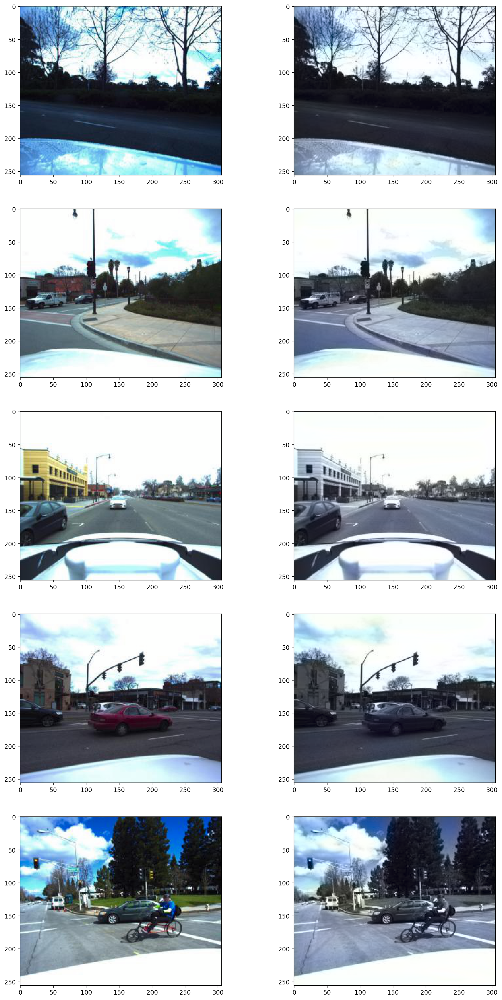

Current training loss is 51.925551
Training iteration 15000 takes 0.050100
Current validatoin loss is 64.865711
Current validation takes 481.048789
Current training loss is 47.663943
Training iteration 15000 takes 0.050461
Current validatoin loss is 92.071417
Current validation takes 430.364398
printing test image


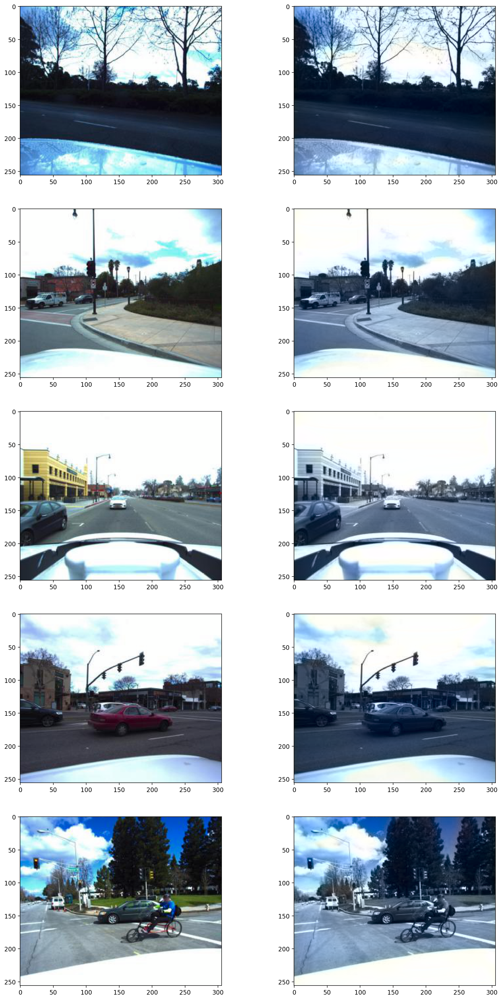

The epoch start is 1588945397.7995467
Current epoch takes 88.516234 min
Epoch 2/3
----------
Current training loss is 43.877445
Training iteration 15000 takes 0.056382
Current validatoin loss is 76.253479
Current validation takes 439.114110
Current training loss is 41.757641
Training iteration 15000 takes 0.050331
Current validatoin loss is 99.269194
Current validation takes 427.501258
printing test image


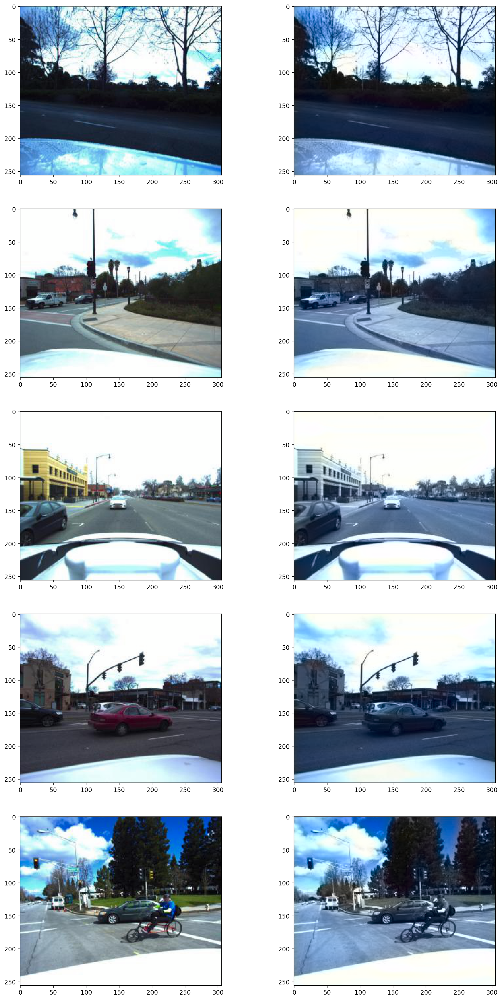

Current training loss is 39.865471
Training iteration 15000 takes 0.050407
Current validatoin loss is 77.782006
Current validation takes 484.192593
Current training loss is 37.700814
Training iteration 15000 takes 0.050620
Current validatoin loss is 102.553592
Current validation takes 477.676683
printing test image


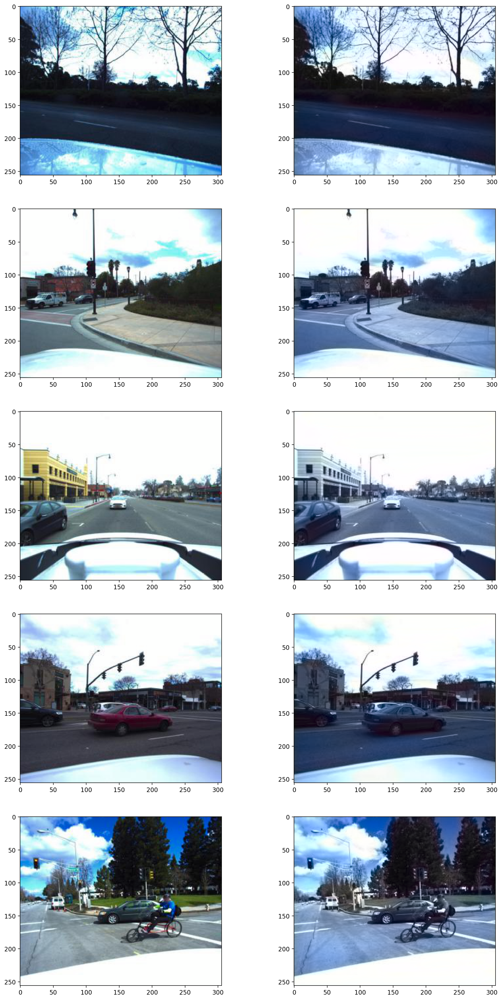

The epoch start is 1588950708.7736242
Current epoch takes 88.409080 min
Epoch 3/3
----------
Current training loss is 36.153931
Training iteration 15000 takes 0.050466
Current validatoin loss is 108.835260
Current validation takes 474.400808
Current training loss is 34.486299
Training iteration 15000 takes 0.050909
Current validatoin loss is 121.915509
Current validation takes 455.894436
printing test image


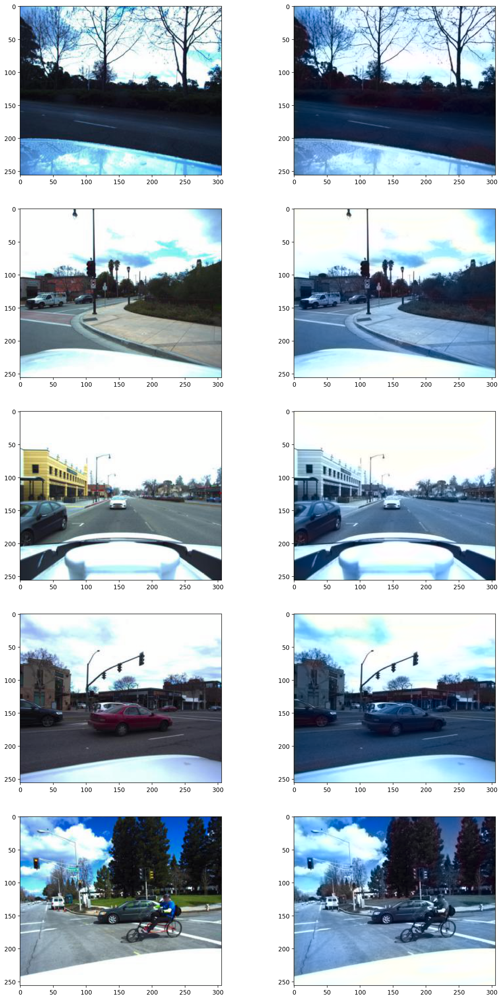

Current training loss is 34.395068
Training iteration 15000 takes 0.051169
Current validatoin loss is 165.350110
Current validation takes 484.827428
Current training loss is 33.270078
Training iteration 15000 takes 0.050859
Current validatoin loss is 93.860525
Current validation takes 444.393357
printing test image


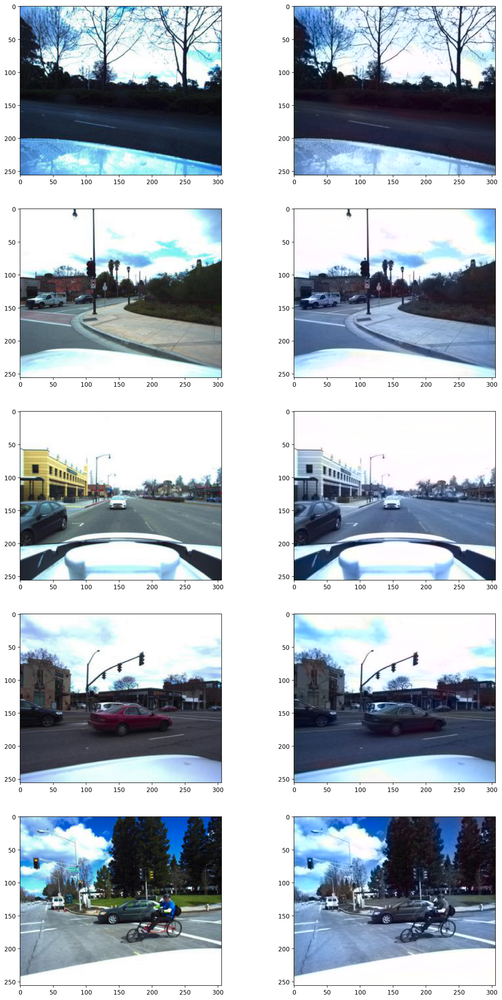

The epoch start is 1588956013.318468
Current epoch takes 90.295693 min


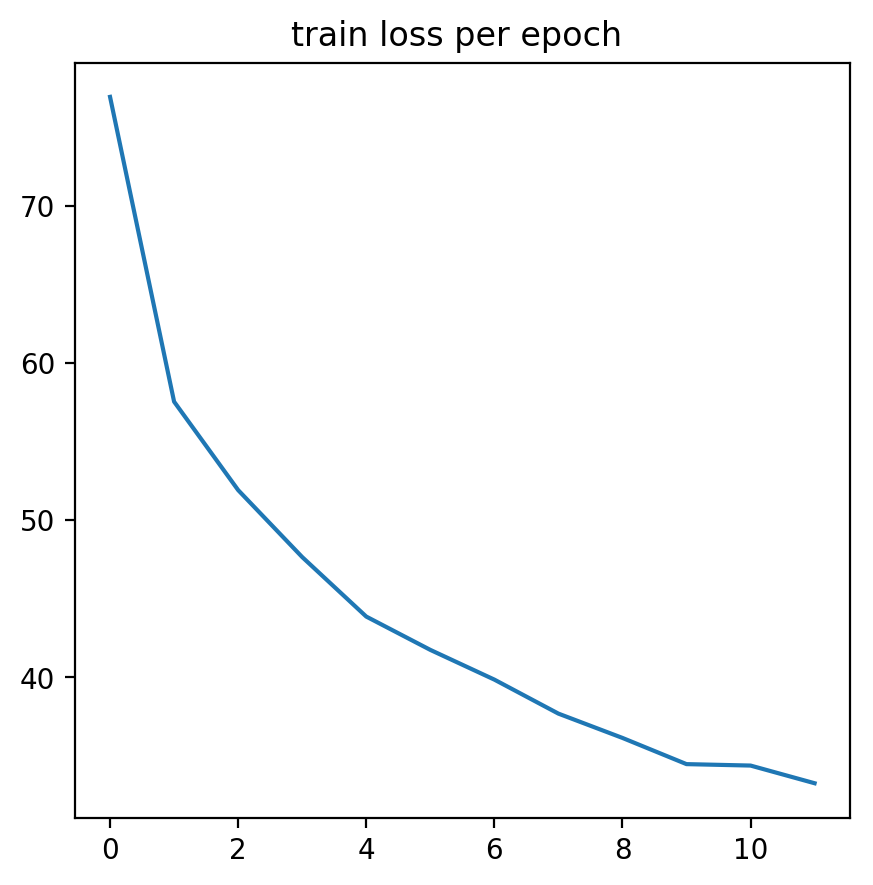

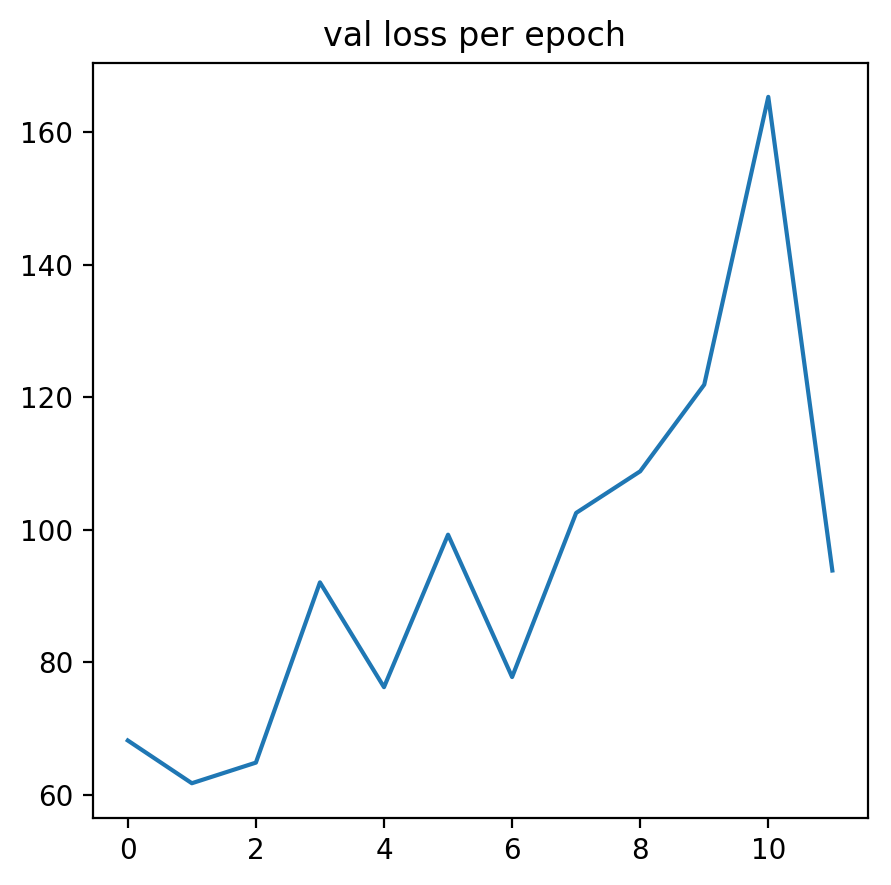

In [47]:
my_model = color_model().to(device)
optimizer = torch.optim.Adam(my_model.parameters(), lr=1e-4)
criterion = nn.MSELoss()

model, loss_dict = train_eval_model(my_model, train_loader, val_loader, criterion, optimizer, 
                                    3, checkpoint=None,
                                    to_save='/scratch/nhl256/dl_project/model/pretrain_colorization_resnet18.pth', 
                                    eval_every=15000, print_every = 30000)


loading weights
Epoch 1/3
----------
Current training loss is 51.417066
Training iteration 15000 takes 0.050985
Current validatoin loss is 71.711783
Current validation takes 434.662178
Current training loss is 47.065651
Training iteration 15000 takes 0.050117
Current validatoin loss is 95.588962
Current validation takes 445.063512
printing test image


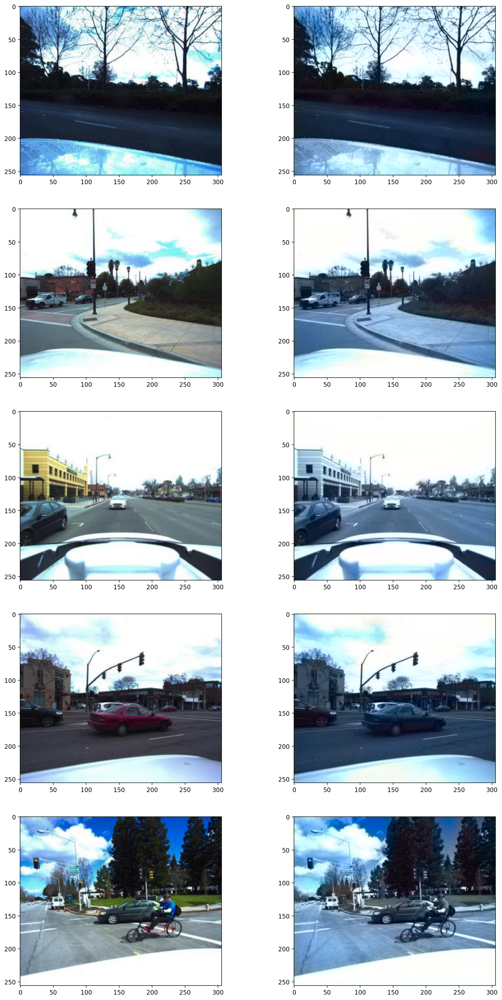

Current training loss is 44.543555
Training iteration 15000 takes 0.050638
Current validatoin loss is 92.537257
Current validation takes 419.529960
Current training loss is 41.878532
Training iteration 15000 takes 0.050649
Current validatoin loss is 107.212407
Current validation takes 431.291769
printing test image


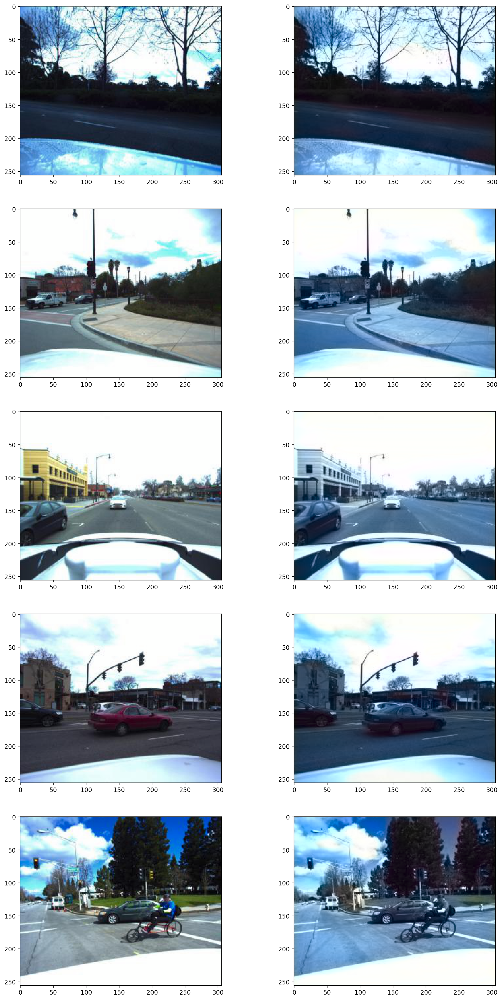

The epoch start is 1588961432.2336645
Current epoch takes 87.175794 min
Epoch 2/3
----------
Current training loss is 39.763397
Training iteration 15000 takes 0.050730
Current validatoin loss is 96.204436
Current validation takes 421.419977
Current training loss is 37.934450
Training iteration 15000 takes 0.050480
Current validatoin loss is 115.883558
Current validation takes 422.875072
printing test image


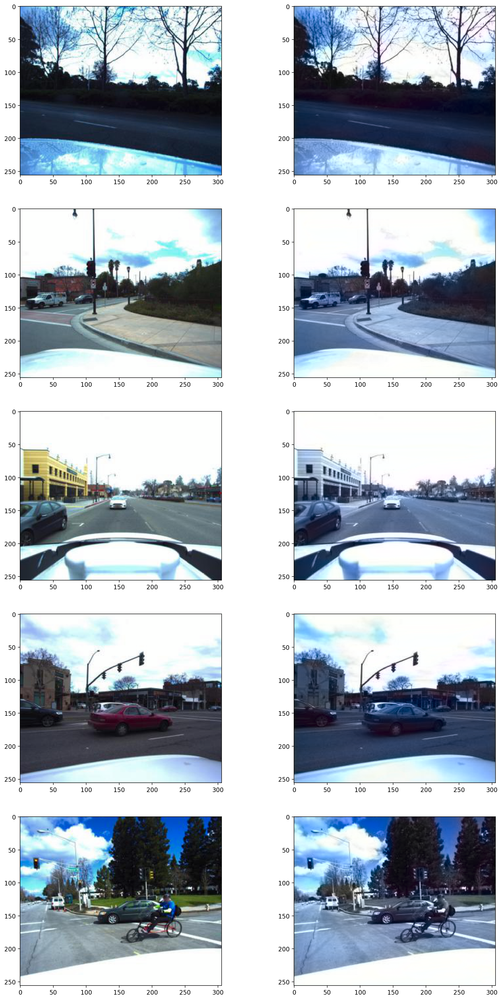

Current training loss is 36.189688
Training iteration 15000 takes 0.050242
Current validatoin loss is 80.269353
Current validation takes 424.497333
Current training loss is 35.227500
Training iteration 15000 takes 0.050566
Current validatoin loss is 102.056903
Current validation takes 441.173753
printing test image


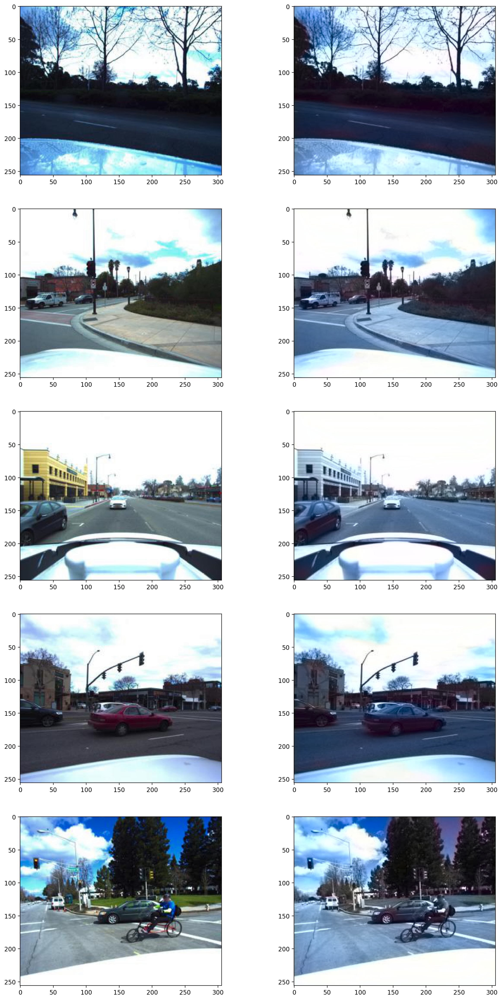

The epoch start is 1588966662.781313
Current epoch takes 85.426650 min
Epoch 3/3
----------
Current training loss is 33.691903
Training iteration 15000 takes 0.051178
Current validatoin loss is 138.134625
Current validation takes 428.072258
Current training loss is 32.173806
Training iteration 15000 takes 0.050567
Current validatoin loss is 95.666382
Current validation takes 422.623437
printing test image


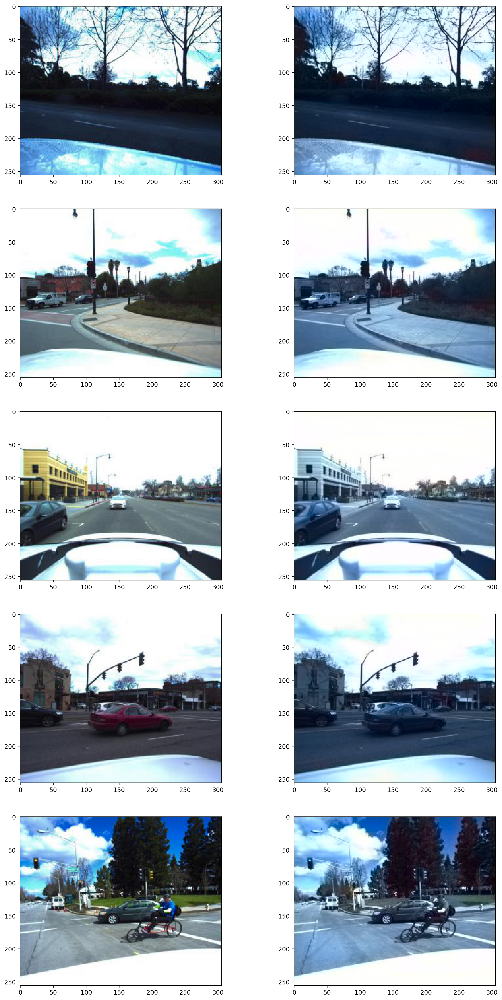

Current training loss is 32.055277
Training iteration 15000 takes 0.050593
Current validatoin loss is 114.012280
Current validation takes 398.559224
Current training loss is 31.601674
Training iteration 15000 takes 0.051321
Current validatoin loss is 107.055924
Current validation takes 435.308016
printing test image


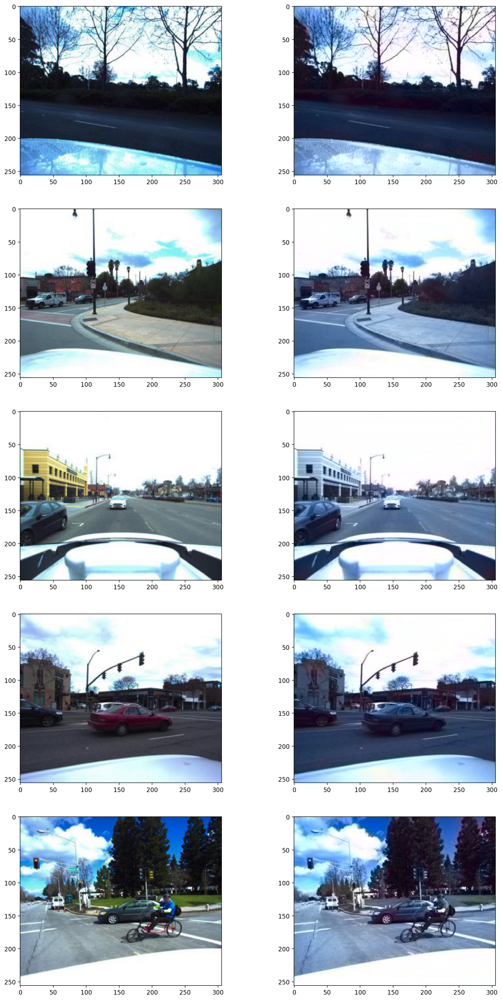

The epoch start is 1588971788.3803349
Current epoch takes 85.277154 min


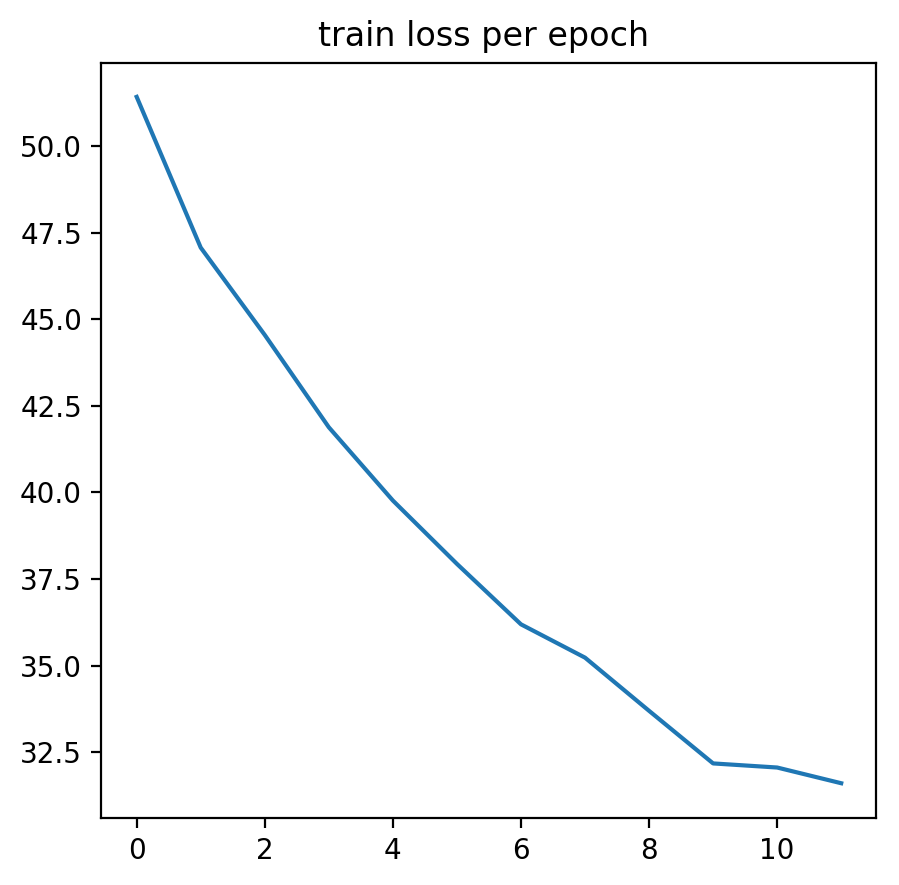

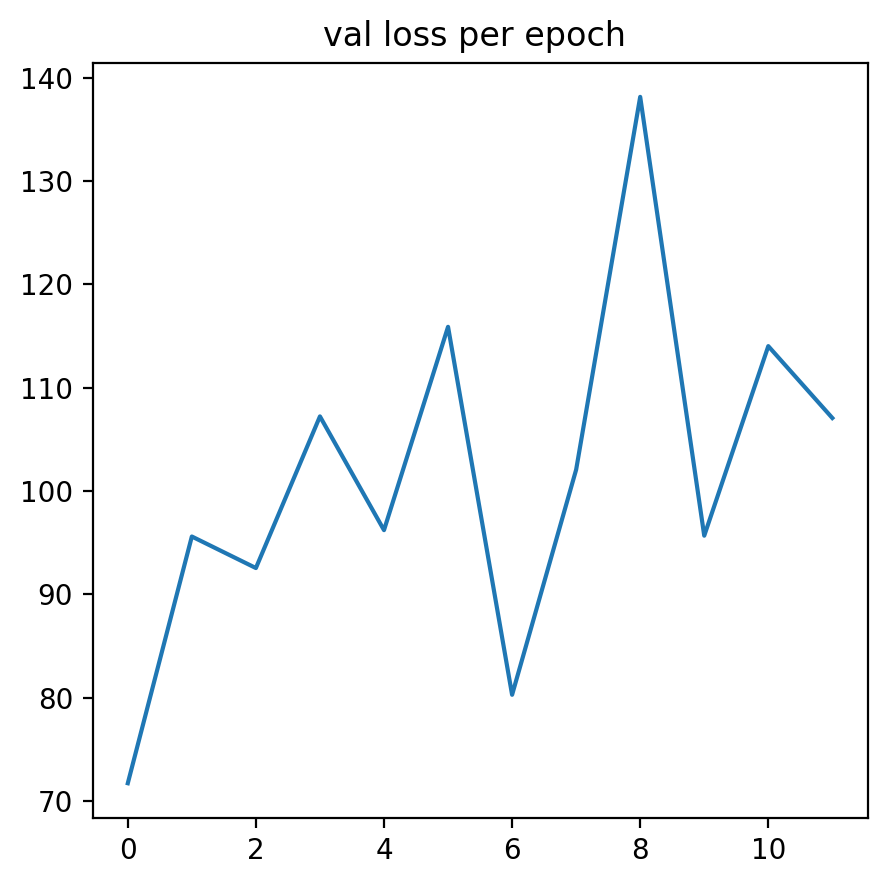

In [48]:
model, loss_dict = train_eval_model(my_model, train_loader, val_loader, criterion, optimizer, 
                                    3,
                                    checkpoint='/scratch/nhl256/dl_project/model/pretrain_colorization_resnet18.pth',
                                    to_save='/scratch/nhl256/dl_project/model/pretrain_colorization_resnet18.pth', 
                                    eval_every=15000,
                                    print_every = 30000)